In [2]:
import os
import numpy as np
import matplotlib.pyplot as plt

import seaborn as sns
sns.set_style("darkgrid")

import pandas as pd
from datetime import datetime,timedelta


#os.chdir('../Python')
#from eda_functions import *
from eda_func_3 import *
from utilities import *

from pandas.plotting import register_matplotlib_converters
register_matplotlib_converters()

In [34]:
data_to_load = "better_odd_tax"

start_date_index = 60

mat_str = data_to_load + ".npy"
dates_str = data_to_load + "_end_dates"

with open(mat_str, 'rb') as f:
    Z_res_1 = np.load(f)
    Z_res_2 = np.load(f)
    Z_res_3 = np.load(f)
    X = np.load(f)
    Y = np.load(f)
e_dates_0 = load(dates_str)
#e_dates_0 = load('test3_end_dates')
e_dates = e_dates_0[start_date_index:]

In [81]:
# Z1  : ROI performance DO NOT ADD!
# Z2  : invest
# Z3  : gain

In [35]:
# Z2_cum = Z_res_2.cumsum(axis=2)
Z1_cum = np.cumsum(Z_res_1[:,:,start_date_index:], axis=2)
Z2_cum = np.cumsum(Z_res_2[:,:,start_date_index:], axis=2)
Z3_cum = np.cumsum(Z_res_3[:,:,start_date_index:], axis=2)

# in absolute

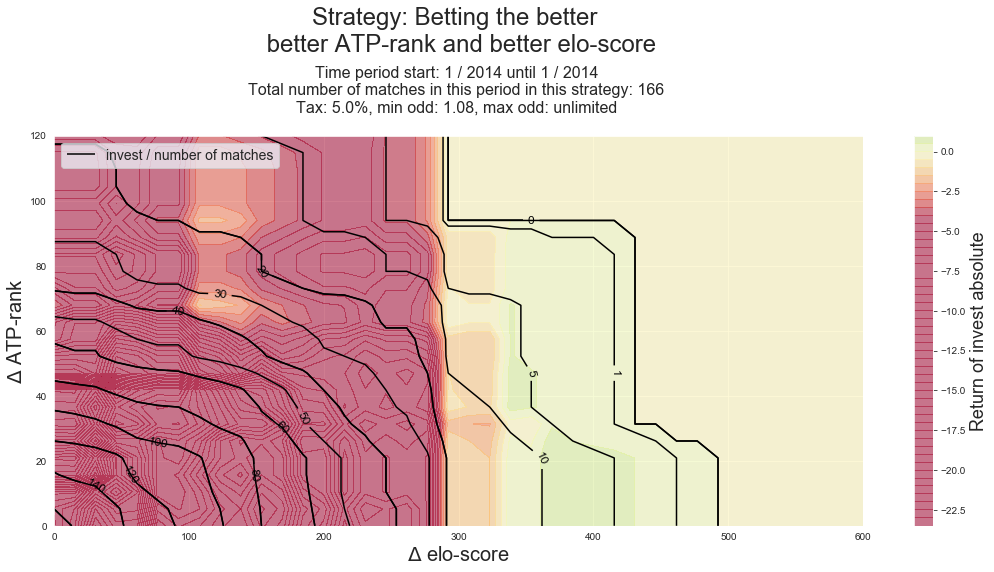

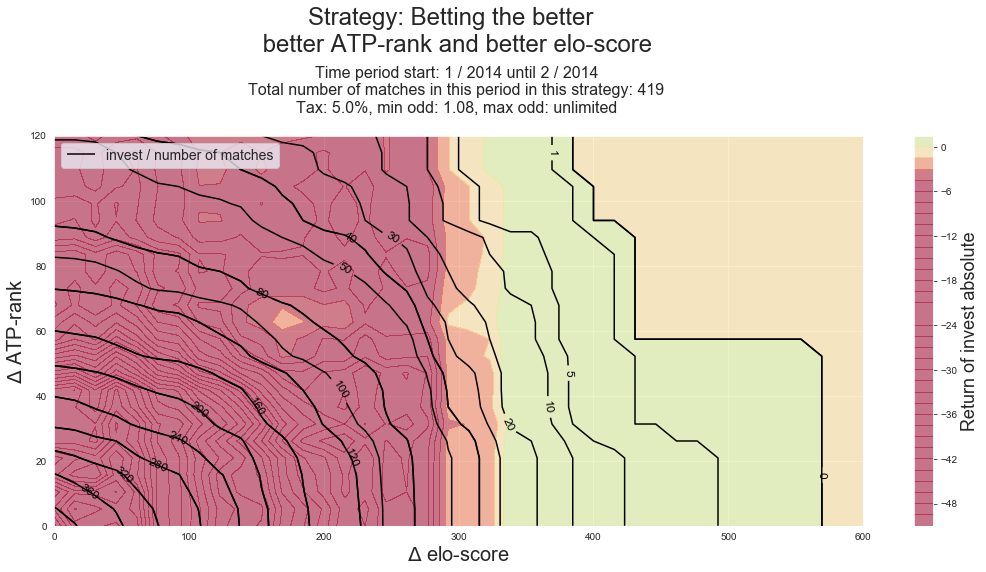

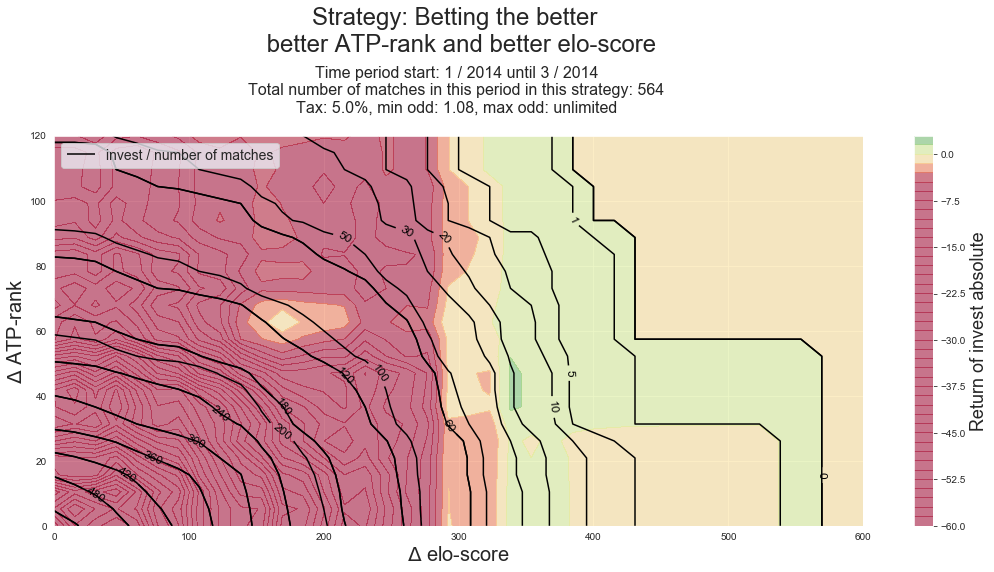

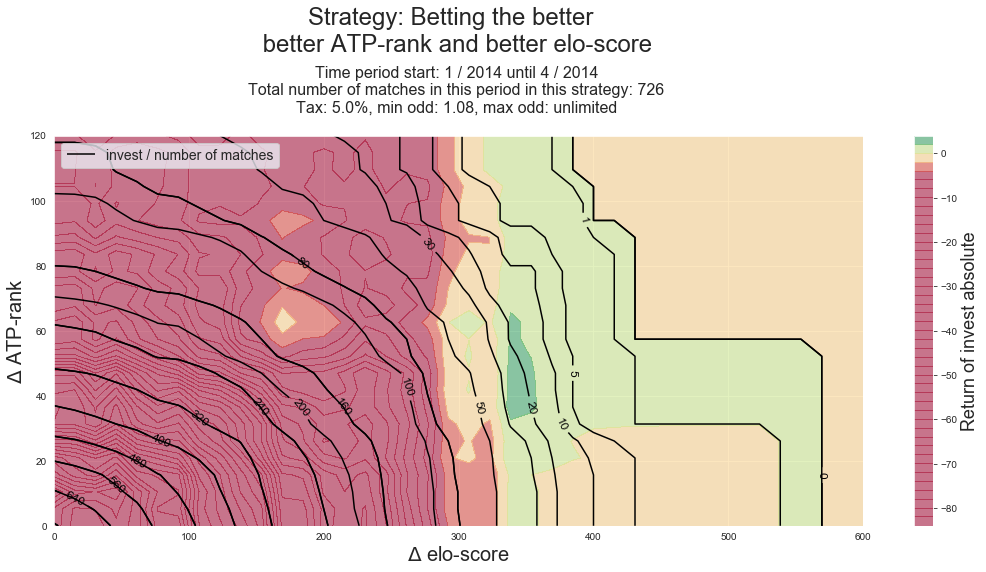

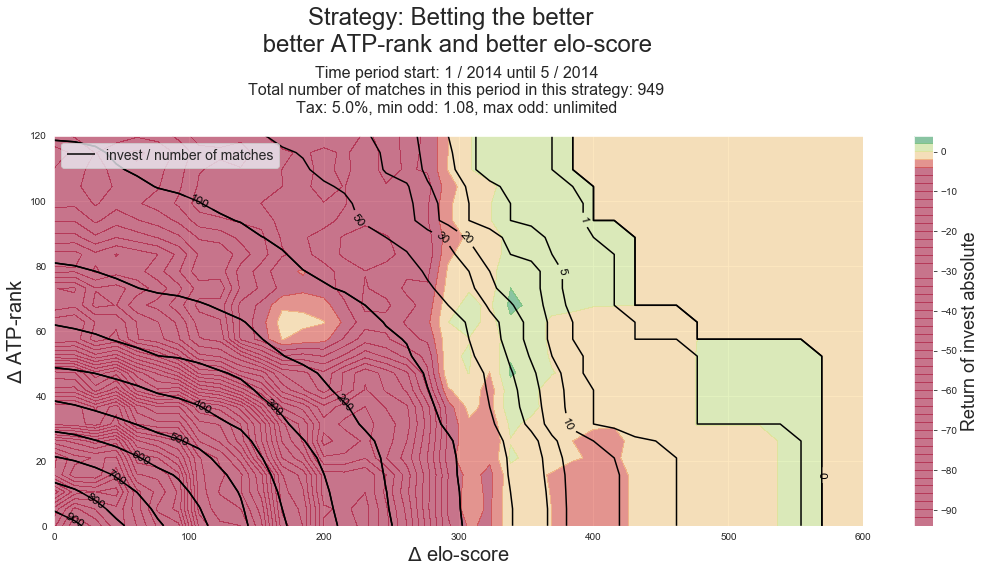

...

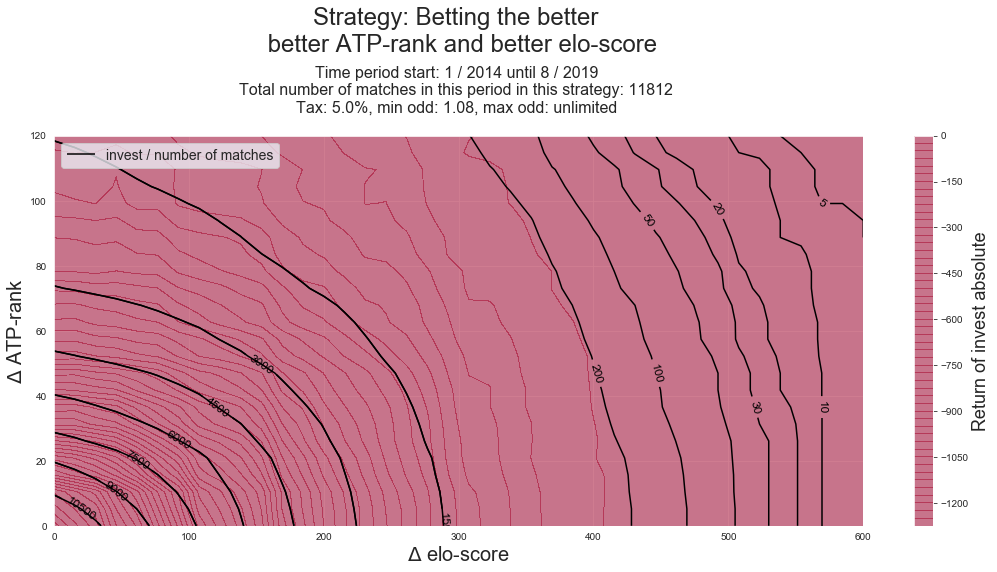

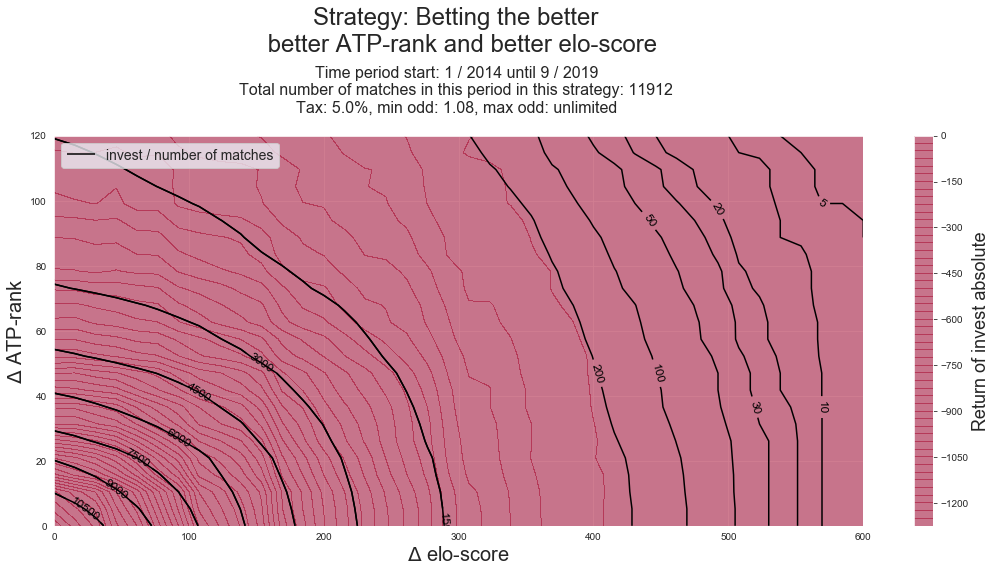

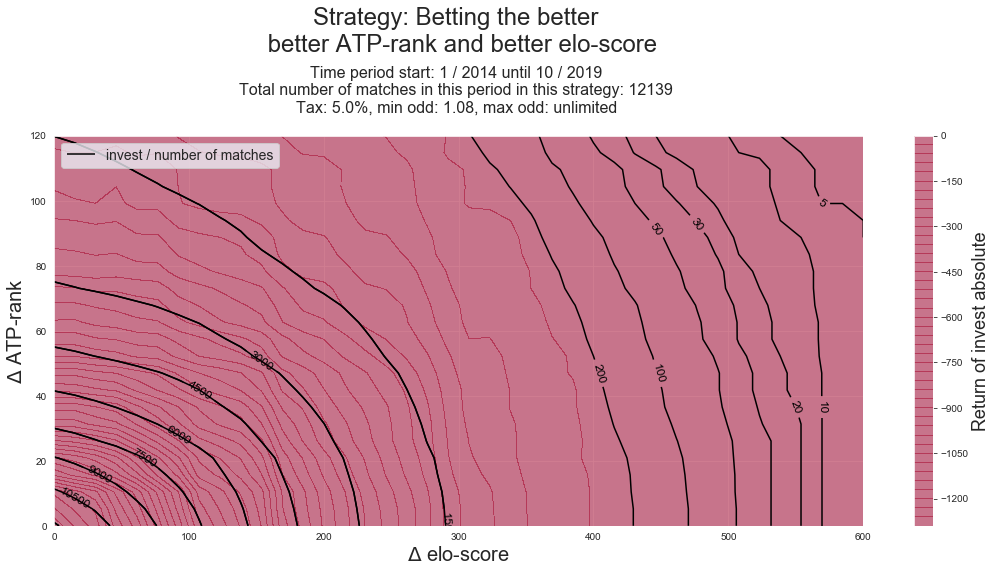

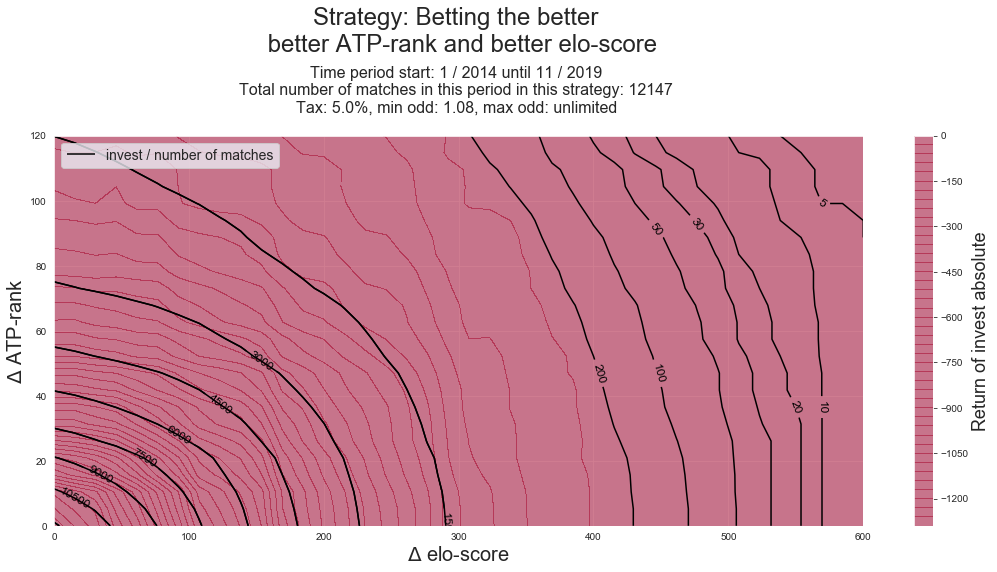

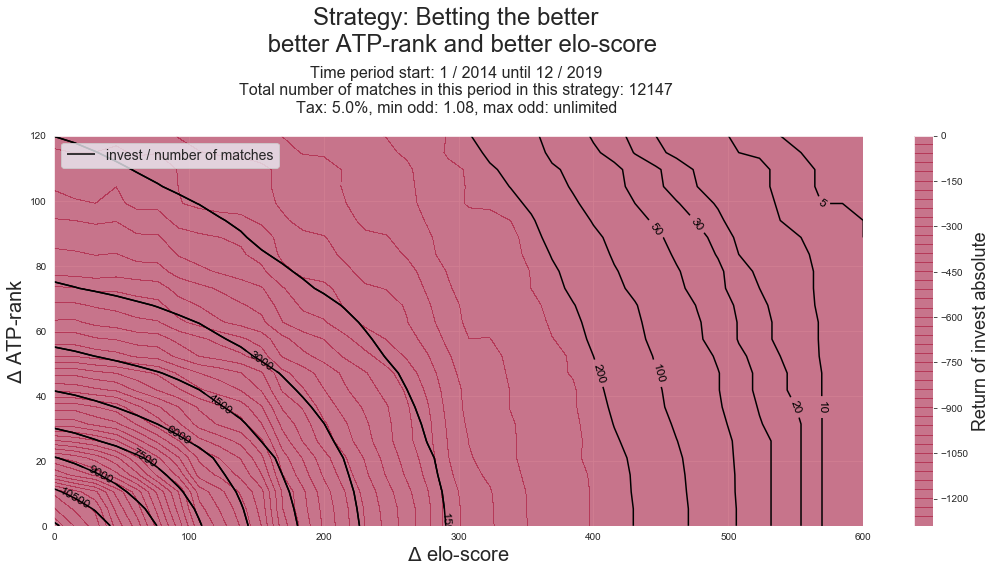

In [36]:
folder = 'better_odd_tax_2014'
filenames = '/better_odd_tax_2014'

if os.path.isdir(folder):
    pass
else:
    os.makedirs(folder)


#path_out = "figures_3/gain_cross_1_perc"
path_out = folder + filenames

for check in range(Z1_cum.shape[2]):
#for check in [50]:

    Z = Z3_cum[:,:,check]
    Z1 = Z2_cum[:,:,check]


    fig, ax = plt.subplots(figsize = (15,8))
    CS = ax.contour(X, Y, Z1, 10, colors='black')

    levs_new = [0.,1.,5.,10.,20.,30.,50.,100.,200.]
    levs_new.extend(CS.levels[1:])
    levels_new = sorted(list(set(levs_new)))

    #levs_new
    del CS
    CS = ax.contour(X, Y, Z1, levels_new, colors='black')


    class nf(float):
        def __repr__(self):
            s = f'{self:.1f}'
            return f'{self:.0f}' if s[-1] == '0' else s

    # Recast levels to new class
    CS.levels = [nf(val) for val in CS.levels]
  
    fmt = '%r'
    ax.clabel(CS, CS.levels, inline=True, fmt=fmt, fontsize=12)

    CS.collections[0].set_label('invest / number of matches')
    plt.legend(loc='upper left', fontsize = 14)

    CS3 = ax.contourf(X, Y, Z, 50, cmap='RdYlGn', alpha=0.5)
    cb = fig.colorbar(CS3)
    cb.set_label('Return of invest absolute', fontsize = 18)
    CS3.set_clim(-4,4)
    
    ax.set_xlabel('$\Delta$ elo-score', fontsize = 20);
    ax.set_ylabel('$\Delta$ ATP-rank', fontsize = 20);

    if check < 10:
        fig_str = path_out + "_00" + str(check) + ".png"
    elif check < 100:   
        fig_str = path_out + "_0" + str(check) + ".png"
    else:
        fig_str = path_out + "_" + str(check) + ".png"
        
    suptitle = 'Strategy: Betting the better \n better ATP-rank and better elo-score'

    title_line_1 = f'Time period start: {e_dates[0].month} / {e_dates[0].year} until {e_dates[check].month} / {e_dates[check].year} \n'
    title_line_2 = f'Total number of matches in this period in this strategy: {int(Z1[0,0])} \n'   
    title_line_3 = f'Tax: 5.0%, min odd: 1.08, max odd: unlimited \n'
    
    ax.set_title(title_line_1 + title_line_2 + title_line_3, fontsize = 16)
    
    fig.get_axes()[0].annotate(suptitle, (0.46, 0.91), 
                            xycoords='figure fraction', ha='center', 
                            fontsize=24
                            )
    
    
    plt.subplots_adjust(top=0.77)
    plt.tight_layout()
    plt.show()
    
    fig.savefig(fig_str)


In [37]:
import glob
from PIL import Image

# filepaths
fp_in = path_out+"_*.png"
fp_out = path_out+".gif"

# https://pillow.readthedocs.io/en/stable/handbook/image-file-formats.html#gif
img, *imgs = [Image.open(f) for f in sorted(glob.glob(fp_in))]
img.save(fp=fp_out, format='GIF', append_images=imgs,
         save_all=True, duration=200, loop=0)

# in percentage

/opt/anaconda3/envs/nf/lib/python3.6/site-packages/ipykernel_launcher.py:16: RuntimeWarning: invalid value encountered in true_divide
  app.launch_new_instance()


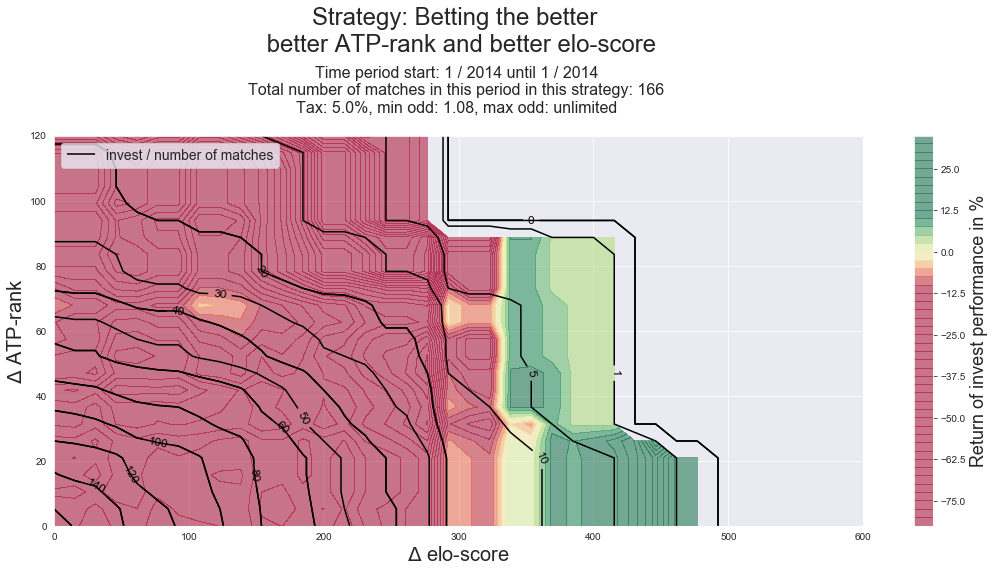

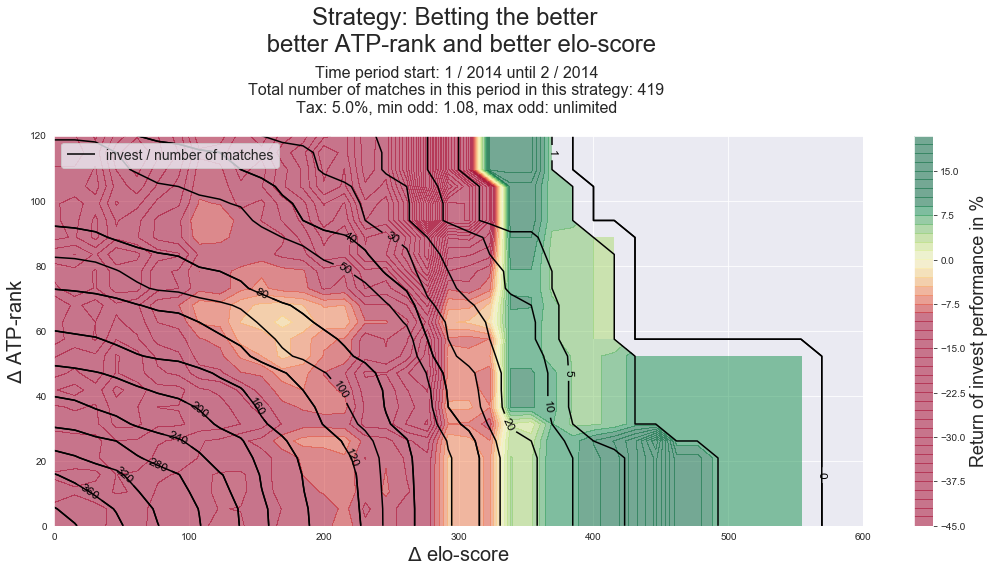

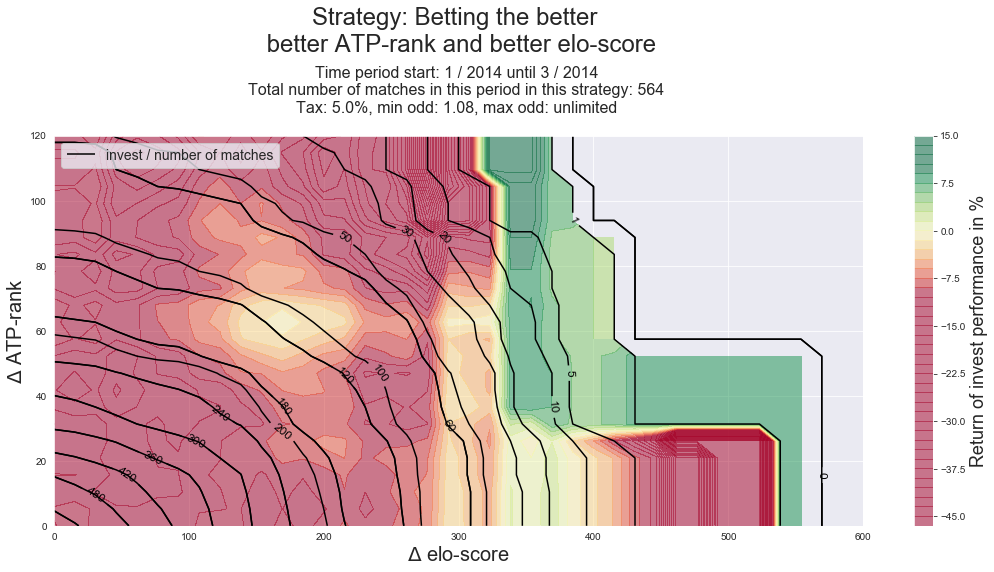

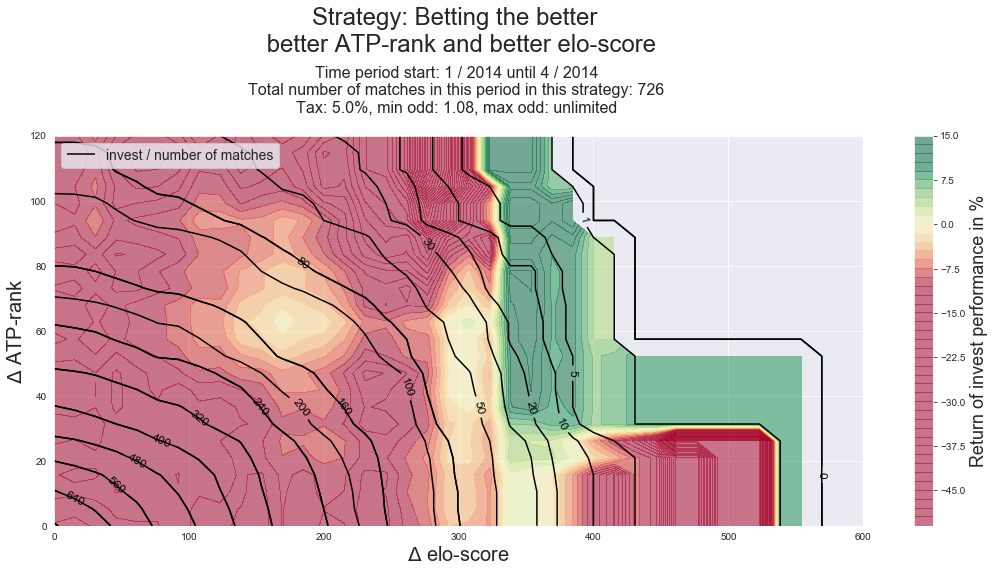

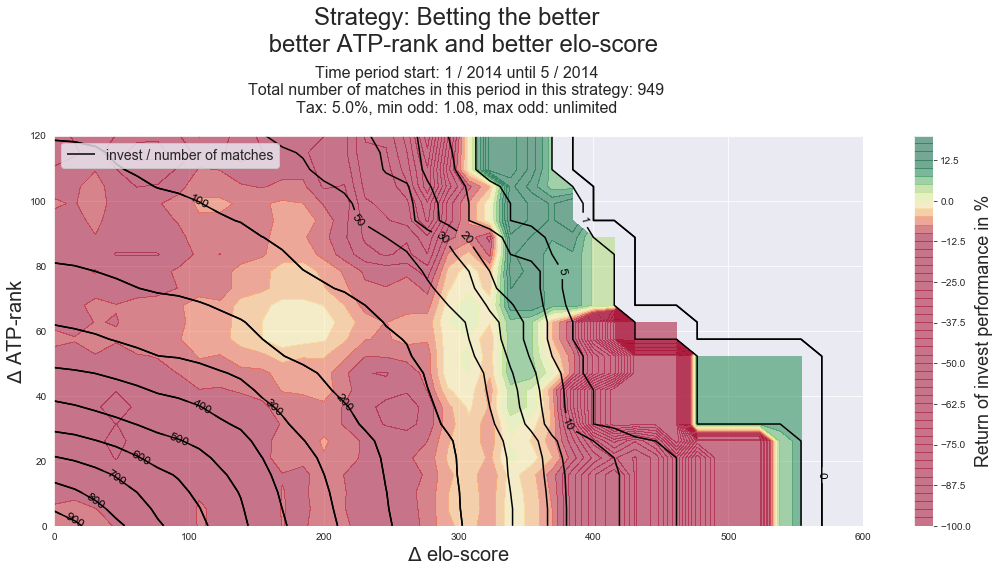

...

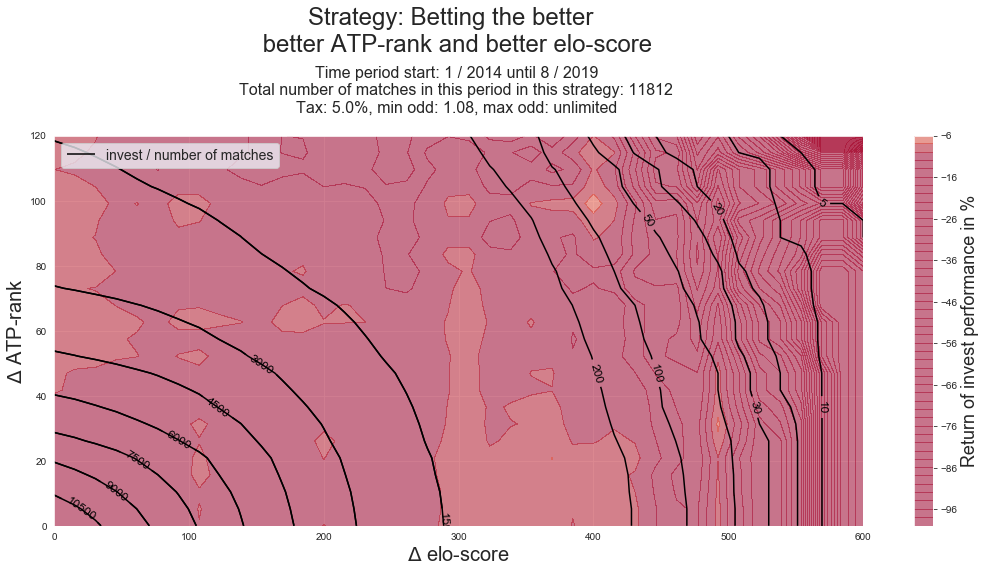

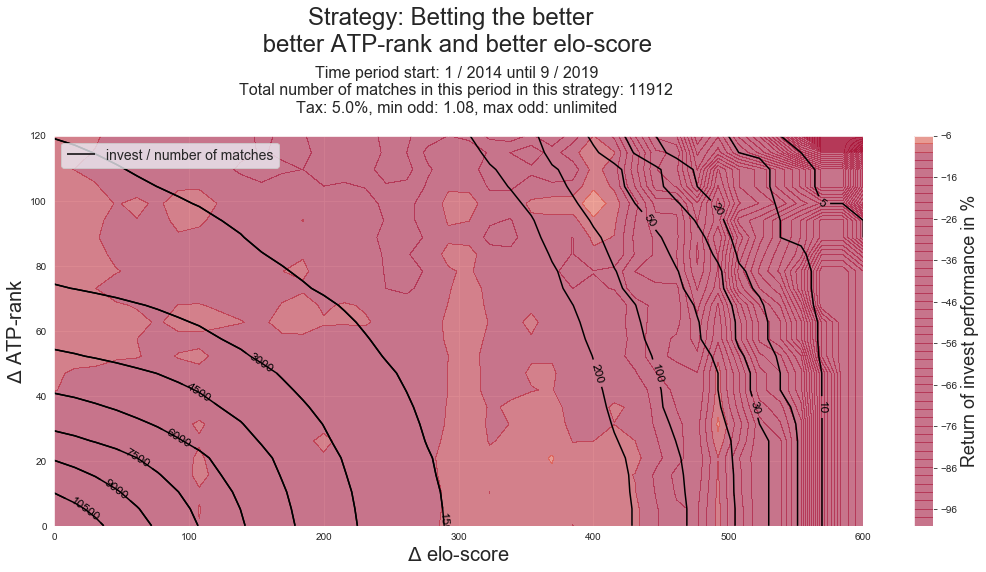

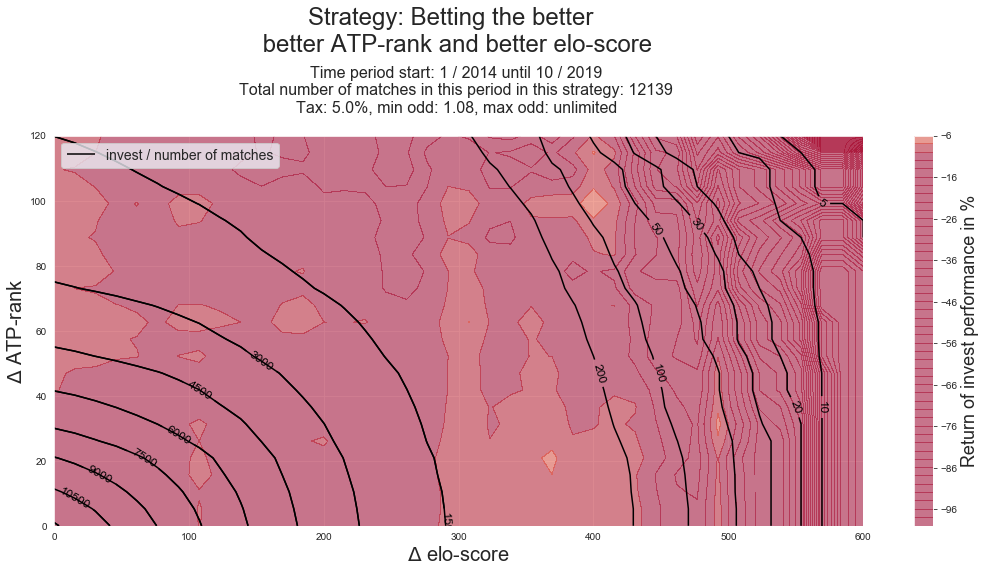

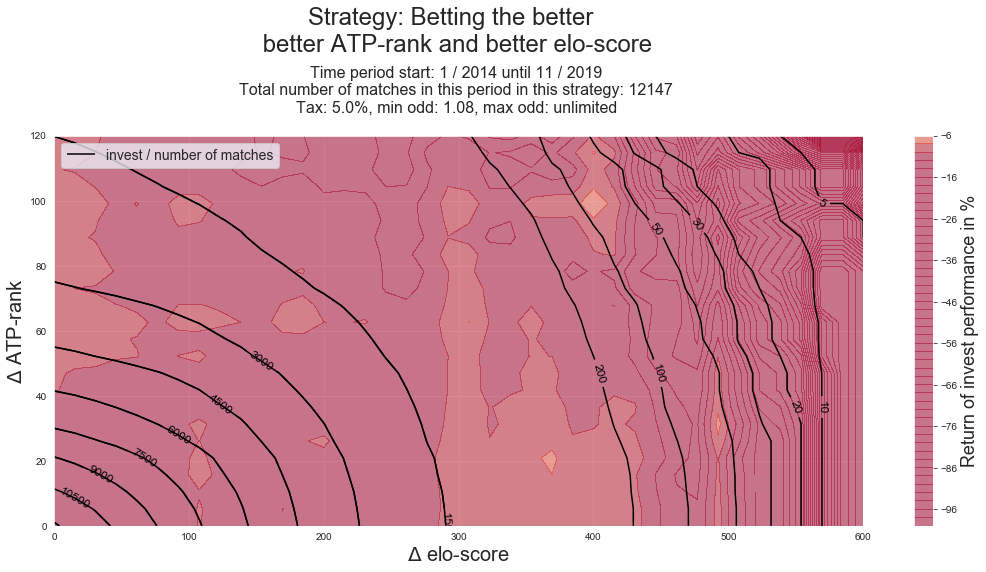

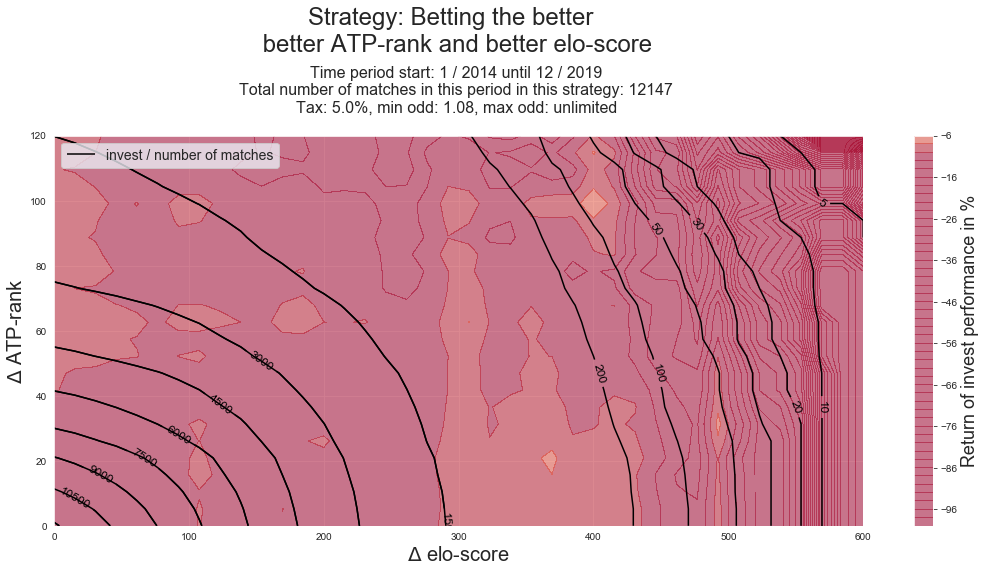

In [38]:
folder = 'better_odd_tax_2014_prec'
filenames = '/better_odd_tax_2014_perc'

if os.path.isdir(folder):
    pass
else:
    os.makedirs(folder)

path_out = folder + filenames

for check in range(Z1_cum.shape[2]):
#for check in [50]:
    Z = Z3_cum[:,:,check]
    Z1 = Z2_cum[:,:,check]
    
    Z7 = (Z/Z1)*100
    Z7[Z7 == np.inf] = 0

    fig, ax = plt.subplots(figsize = (15,8))
    CS = ax.contour(X, Y, Z1, 10, colors='black')
    
    # adding lowe levels
    levs_new = [0.,1.,5.,10.,20.,30.,50.,100.,200.]
    levs_new.extend(CS.levels[1:])
    levels_new = sorted(list(set(levs_new)))

    #levs_new
    del CS
    CS = ax.contour(X, Y, Z1, levels_new, colors='black')


    class nf(float):
        def __repr__(self):
            s = f'{self:.1f}'
            return f'{self:.0f}' if s[-1] == '0' else s

    # Recast levels to new class
    CS.levels = [nf(val) for val in CS.levels]

    fmt = '%r'
    ax.clabel(CS, CS.levels, inline=True, fmt=fmt, fontsize=12)

    CS.collections[0].set_label('invest / number of matches')
    plt.legend(loc='upper left', fontsize = 14)


    #CS3 = ax.contourf(X, Y, Z, 50, cmap='RdYlGn', alpha=0.5)
    CS3 = ax.contourf(X, Y, Z7, 50, cmap='RdYlGn', alpha=0.5)
    cb = fig.colorbar(CS3)
    cb.set_label('Return of invest performance in %', fontsize = 18)
    #CS3.set_clim(-0.15,0.15)
    CS3.set_clim(-10,10)
    
    

    ax.set_xlabel('$\Delta$ elo-score', fontsize = 20);
    ax.set_ylabel('$\Delta$ ATP-rank', fontsize = 20);
    
    '''
    if check < 10:
        fig_str = "figures_1/gain_better_00" + str(check) + ".png"
    elif check < 100:   
        fig_str = "figures_1/gain_better_0" + str(check) + ".png"
    else:
        fig_str = "figures_1/gain_better_" + str(check) + ".png"
 '''

    if check < 10:
        fig_str = path_out + "_00" + str(check) + ".png"
    elif check < 100:   
        fig_str = path_out + "_0" + str(check) + ".png"
    else:
        fig_str = path_out + "_" + str(check) + ".png"
    
    
    suptitle = 'Strategy: Betting the better \n better ATP-rank and better elo-score'

    
    title_line_1 = f'Time period start: {e_dates[0].month} / {e_dates[0].year} until {e_dates[check].month} / {e_dates[check].year} \n'
    title_line_2 = f'Total number of matches in this period in this strategy: {int(Z1[0,0])} \n'   
    title_line_3 = f'Tax: 5.0%, min odd: 1.08, max odd: unlimited \n'
    
    ax.set_title(title_line_1 + title_line_2 + title_line_3, fontsize = 16)
    #ax.set_title('Betting the better')
    
    fig.get_axes()[0].annotate(suptitle, (0.46, 0.91), 
                            xycoords='figure fraction', ha='center', 
                            fontsize=24
                            )
    
    
    plt.subplots_adjust(top=0.77)
    plt.tight_layout()
    plt.show()
    
    fig.savefig(fig_str)


In [39]:
import glob
from PIL import Image

# filepaths
#fp_in = "figures_1/gain_better_*.png"
#fp_out = "figures_1/gain_better_.gif"
fp_in = path_out+"_*.png"
fp_out = path_out+".gif"

# https://pillow.readthedocs.io/en/stable/handbook/image-file-formats.html#gif
img, *imgs = [Image.open(f) for f in sorted(glob.glob(fp_in))]
img.save(fp=fp_out, format='GIF', append_images=imgs,
         save_all=True, duration=200, loop=1)